##### Copyright 2025 Google LLC.

In [31]:
# @title Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
# https://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

# Langchain With Gemini And Build RAG
This GitHub notebook demonstrates how to build a **Retrieval-Augmented Generation (RAG) pipeline** using **LangChain and Google Gemini**, showing document ingestion (PDFs/text), text splitting, embedding generation with Gemini's `models/embedding-001`, vector storage in ChromaDB, and contextual question-answering with Gemini Pro. It provides a practical implementation for creating AI-powered Q&A systems from custom documents, including error handling for API/model setup. Ideal for developers exploring RAG with Gemini, it requires `langchain-google-genai`, `chromadb`, and `pypdf` to run. A concise, ready-to-use example for enhancing LLM applications with retrieval-based knowledge.

<a target="_blank" href="https://colab.research.google.com/github/google-gemini/cookbook/blob/main/examples/langchain/Langchain_With_Gemini_And_Build_RAG.ipynb"><img src="https://colab.research.google.com/assets/colab-badge.svg" height=30/></a>

In [32]:
%pip install -U -q "google-genai>=1.0.0"

In [33]:
from google import genai

from IPython.display import Markdown

## Configure your API key

To run the following cell, your API key must be stored it in a Colab Secret named `GOOGLE_API_KEY`. If you don't already have an API key, or you're not sure how to create a Colab Secret, see [Authentication](https://github.com/google-gemini/cookbook/blob/main/quickstarts/Authentication.ipynb) for an example.

In [34]:
from google.colab import userdata
GOOGLE_API_KEY = userdata.get('GOOGLE_API_KEY')
client = genai.Client(api_key=GOOGLE_API_KEY)

In [35]:
MODEL_ID="gemini-2.0-flash" # @param ["gemini-2.0-flash-lite","gemini-2.0-flash","gemini-2.5-pro-exp-03-25"] {"allow-input":true, isTemplate: true}

In [36]:
! pip install -q --upgrade google-generativeai langchain-google-genai chromadb pypdf

In [37]:
from IPython.display import display
from IPython.display import Markdown
import textwrap


def to_markdown(text):
  text = text.replace('•', '  *')
  return Markdown(textwrap.indent(text, '> ', predicate=lambda _: True))

In [38]:
import google.generativeai as genai
from google.colab import userdata

In [39]:
import os
GOOGLE_API_KEY=userdata.get('GOOGLE_API_KEY')
genai.configure(api_key=GOOGLE_API_KEY)

# Text Generation

In [40]:
model = genai.GenerativeModel(model_name = MODEL_ID)
model

genai.GenerativeModel(
    model_name='models/gemini-2.0-flash',
    generation_config={},
    safety_settings={},
    tools=None,
    system_instruction=None,
    cached_content=None
)

In [41]:
response = model.generate_content("What are the usecases of LLMs?")

In [42]:
to_markdown(response.text)

> Large Language Models (LLMs) have a vast and rapidly growing range of use cases across various industries. Here's a breakdown of some key areas:
> 
> **1. Content Creation & Writing:**
> 
> *   **Generating Text:** LLMs excel at producing various types of text, including articles, blog posts, marketing copy, scripts, poems, emails, social media updates, and even entire books.
> *   **Summarization:** They can condense long documents, articles, or threads into concise summaries, saving time and effort.
> *   **Paraphrasing:** Rewriting existing content in a different style or tone while preserving the original meaning.
> *   **Translation:** Translating text from one language to another, often with impressive accuracy.
> *   **Creative Writing:** Assisting writers with brainstorming ideas, generating plotlines, and developing characters.
> *   **Code Generation:** LLMs can generate code in various programming languages based on natural language descriptions.
> 
> **2. Customer Service & Support:**
> 
> *   **Chatbots:** Powering conversational AI agents that handle customer inquiries, provide support, and resolve issues.
> *   **Automated Email Responses:** Generating personalized email replies based on customer queries.
> *   **FAQ Generation:** Creating and maintaining comprehensive FAQs by analyzing customer interactions.
> *   **Ticket Routing:** Automatically categorizing and routing support tickets to the appropriate departments.
> *   **Sentiment Analysis:**  Analyzing customer feedback to identify positive, negative, or neutral sentiment, enabling businesses to understand customer satisfaction.
> 
> **3. Information Retrieval & Search:**
> 
> *   **Enhanced Search Engines:** Improving search accuracy and relevance by understanding the context and intent of user queries.
> *   **Question Answering:** Providing direct answers to questions based on a vast knowledge base.
> *   **Knowledge Base Management:** Organizing and maintaining large volumes of information for easy access and retrieval.
> *   **Research Assistance:** Helping researchers find relevant articles, studies, and data.
> 
> **4. Software Development & Engineering:**
> 
> *   **Code Completion:** Suggesting code snippets and completing code blocks, increasing developer productivity.
> *   **Bug Detection:** Identifying potential bugs and vulnerabilities in code.
> *   **Code Documentation:** Generating documentation for codebases.
> *   **Code Translation:** Converting code from one programming language to another.
> *   **API Integration:** Assisting developers in integrating different APIs.
> *   **Test Case Generation:** Creating test cases to ensure code quality.
> 
> **5. Education & Learning:**
> 
> *   **Personalized Tutoring:** Providing customized learning experiences based on student needs and learning styles.
> *   **Content Creation for Educational Materials:** Generating quizzes, assignments, and study guides.
> *   **Language Learning:** Providing feedback on grammar, pronunciation, and vocabulary.
> *   **Essay Grading:** Automating the grading of essays and providing feedback to students.
> 
> **6. Business Intelligence & Analytics:**
> 
> *   **Data Analysis:** Analyzing large datasets to identify trends, patterns, and insights.
> *   **Report Generation:** Creating automated reports based on data analysis.
> *   **Forecasting:** Predicting future trends based on historical data.
> *   **Market Research:** Analyzing market data to understand customer behavior and competitive landscapes.
> 
> **7. Healthcare & Medicine:**
> 
> *   **Medical Diagnosis Assistance:** Supporting doctors in diagnosing diseases by analyzing patient data and medical literature.
> *   **Drug Discovery:** Accelerating the drug discovery process by analyzing large datasets of chemical compounds and biological interactions.
> *   **Personalized Medicine:** Tailoring treatment plans based on individual patient characteristics.
> *   **Patient Education:** Providing patients with information about their health conditions and treatment options.
> *   **Medical Note Summarization:** Summarizing lengthy medical records.
> 
> **8. Finance & Banking:**
> 
> *   **Fraud Detection:** Identifying fraudulent transactions by analyzing financial data.
> *   **Risk Assessment:** Assessing the risk associated with loans and investments.
> *   **Customer Service:** Providing personalized financial advice to customers.
> *   **Algorithmic Trading:** Developing trading algorithms based on market data.
> 
> **9. Legal:**
> 
> *   **Legal Research:** Assisting lawyers in finding relevant case law and statutes.
> *   **Contract Review:** Analyzing contracts to identify potential risks and liabilities.
> *   **Document Summarization:** Summarizing lengthy legal documents.
> *   **Legal Drafting:** Assisting lawyers in drafting legal documents.
> 
> **10. Entertainment & Gaming:**
> 
> *   **Generating Dialogue for Characters:** Creating realistic and engaging dialogue for game characters.
> *   **Creating Storylines and Quests:** Developing immersive storylines and quests for games.
> *   **Generating Music and Sound Effects:** Creating original music and sound effects for games and other media.
> *   **Personalized Recommendations:** Recommending movies, TV shows, and games based on user preferences.
> 
> **11. Other Applications:**
> 
> *   **Accessibility:**  Transcribing audio into text for the hearing impaired, or generating audio descriptions for the visually impaired.
> *   **Social Media Management:**  Scheduling posts, generating captions, and analyzing social media engagement.
> *   **Supply Chain Optimization:**  Predicting demand and optimizing inventory levels.
> *   **Agriculture:**  Analyzing weather data and soil conditions to optimize crop yields.
> 
> **Key Considerations and Limitations:**
> 
> *   **Bias:** LLMs can inherit biases from the data they are trained on, leading to unfair or discriminatory outputs.
> *   **Hallucinations:** LLMs can sometimes generate incorrect or nonsensical information (hallucinations).
> *   **Ethical Concerns:**  LLMs raise ethical concerns about plagiarism, misinformation, and the potential for misuse.
> *   **Computational Resources:** Training and deploying LLMs can require significant computational resources.
> *   **Context Understanding:** While improving, LLMs can still struggle with complex contexts and nuanced meanings.
> *   **Data Privacy:**  Using LLMs with sensitive data requires careful consideration of data privacy regulations.
> 
> The field of LLMs is rapidly evolving, and new use cases are emerging constantly. As these models become more sophisticated, they are poised to transform many aspects of our lives and work.


# Use LangChain to Access Gemini API

In [43]:
from langchain_google_genai import ChatGoogleGenerativeAI

In [44]:
llm = ChatGoogleGenerativeAI(model= MODEL_ID,google_api_key=GOOGLE_API_KEY)

In [45]:
result = llm.invoke("What are the usecases of LLMs?")

In [46]:
to_markdown(result.content)

> LLMs (Large Language Models) have a vast and rapidly expanding range of use cases across various industries and applications. Here's a breakdown of some of the most prominent and impactful areas:
> 
> **I. Content Creation & Writing:**
> 
> *   **Generating text:**
>     *   **Articles and blog posts:** LLMs can create informative and engaging content on various topics, saving time and effort for writers.
>     *   **Marketing copy:** Generating ad copy, slogans, email subject lines, and social media posts.
>     *   **Product descriptions:**  Creating compelling and informative descriptions for e-commerce.
>     *   **Creative writing:**  Generating stories, poems, scripts, and even song lyrics.
> *   **Summarization:**  Condensing large documents, articles, or reports into concise summaries.
> *   **Translation:**  Translating text between multiple languages with increasing accuracy.
> *   **Proofreading and editing:**  Identifying and correcting grammatical errors, typos, and stylistic inconsistencies.
> *   **Content repurposing:**  Transforming existing content into different formats (e.g., turning a blog post into a presentation).
> *   **Script Writing:**  Generating scripts for videos, podcasts, or even movies.
> 
> **II. Customer Service & Support:**
> 
> *   **Chatbots:**  Providing instant answers to customer inquiries, resolving common issues, and escalating complex cases to human agents.
> *   **Virtual assistants:**  Assisting customers with tasks such as booking appointments, tracking orders, and managing accounts.
> *   **Personalized recommendations:**  Suggesting relevant products, services, or content based on customer preferences.
> *   **Sentiment analysis:**  Analyzing customer feedback (e.g., reviews, surveys) to identify areas for improvement.
> *   **Automated email responses:**  Generating personalized and informative email replies to customer inquiries.
> 
> **III. Information Retrieval & Search:**
> 
> *   **Enhanced search engines:**  Providing more relevant and accurate search results by understanding the context and intent of user queries.
> *   **Question answering:**  Directly answering user questions based on a knowledge base or the web.
> *   **Knowledge base creation and maintenance:**  Automatically building and updating knowledge bases from various sources.
> *   **Research assistance:**  Helping researchers find relevant papers, summarize findings, and identify key trends.
> 
> **IV. Software Development & Engineering:**
> 
> *   **Code generation:**  Generating code snippets, complete functions, or even entire programs based on natural language descriptions.
> *   **Code completion:**  Suggesting code completions as developers type, improving coding speed and reducing errors.
> *   **Code documentation:**  Automatically generating documentation for code, making it easier to understand and maintain.
> *   **Code translation:**  Translating code between different programming languages.
> *   **Bug detection and fixing:**  Identifying potential bugs in code and suggesting fixes.
> *   **API integration:**  Simplifying the process of integrating different APIs into applications.
> 
> **V. Education & Training:**
> 
> *   **Personalized learning:**  Creating customized learning experiences based on individual student needs and progress.
> *   **Automated grading:**  Grading essays, quizzes, and other assignments, providing feedback to students.
> *   **Language tutoring:**  Providing personalized language learning support and practice.
> *   **Content creation for educational materials:** Generating quizzes, exercises, and other learning materials.
> *   **Researching and summarizing educational topics.**
> 
> **VI. Business & Finance:**
> 
> *   **Market research:**  Analyzing market trends, identifying opportunities, and assessing competitive landscapes.
> *   **Financial modeling:**  Creating financial models and forecasts based on historical data and market assumptions.
> *   **Risk assessment:**  Identifying and assessing potential risks to businesses and investments.
> *   **Fraud detection:**  Detecting fraudulent transactions and activities.
> *   **Report generation:**  Automating the creation of business reports and presentations.
> 
> **VII. Healthcare:**
> 
> *   **Medical diagnosis:**  Assisting doctors in diagnosing diseases based on patient symptoms and medical history.
> *   **Drug discovery:**  Accelerating the drug discovery process by identifying potential drug candidates and predicting their efficacy.
> *   **Personalized medicine:**  Tailoring treatments to individual patients based on their genetic makeup and other factors.
> *   **Medical record summarization:**  Summarizing patient medical records for easier access and review.
> *   **Patient education:**  Providing patients with information about their health conditions and treatment options.
> 
> **VIII. Legal:**
> 
> *   **Legal research:**  Assisting lawyers in finding relevant case law and legal precedents.
> *   **Contract review:**  Analyzing contracts for potential risks and liabilities.
> *   **Document summarization:**  Summarizing legal documents for easier review.
> *   **Legal writing:**  Assisting lawyers in drafting legal documents.
> 
> **IX. Other Emerging Use Cases:**
> 
> *   **Gaming:**  Generating dialogue for game characters, creating dynamic storylines, and even designing entire game worlds.
> *   **Art and music generation:**  Creating original works of art and music.
> *   **Robotics:**  Enabling robots to understand and respond to natural language commands.
> *   **Accessibility:**  Creating tools that make technology more accessible to people with disabilities.
> 
> **Key Considerations & Challenges:**
> 
> *   **Bias:** LLMs can inherit and amplify biases present in the data they are trained on.
> *   **Hallucinations:** LLMs can sometimes generate incorrect or nonsensical information.
> *   **Cost:** Training and deploying LLMs can be expensive.
> *   **Ethical concerns:** LLMs can be used for malicious purposes, such as creating fake news or generating spam.
> *   **Data privacy:** LLMs require large amounts of data, which can raise privacy concerns.
> *   **Explainability:**  Understanding how LLMs arrive at their decisions can be difficult.
> 
> The field of LLMs is constantly evolving, and new use cases are emerging all the time.  As LLMs become more powerful and accessible, they are likely to have an even greater impact on society in the years to come.

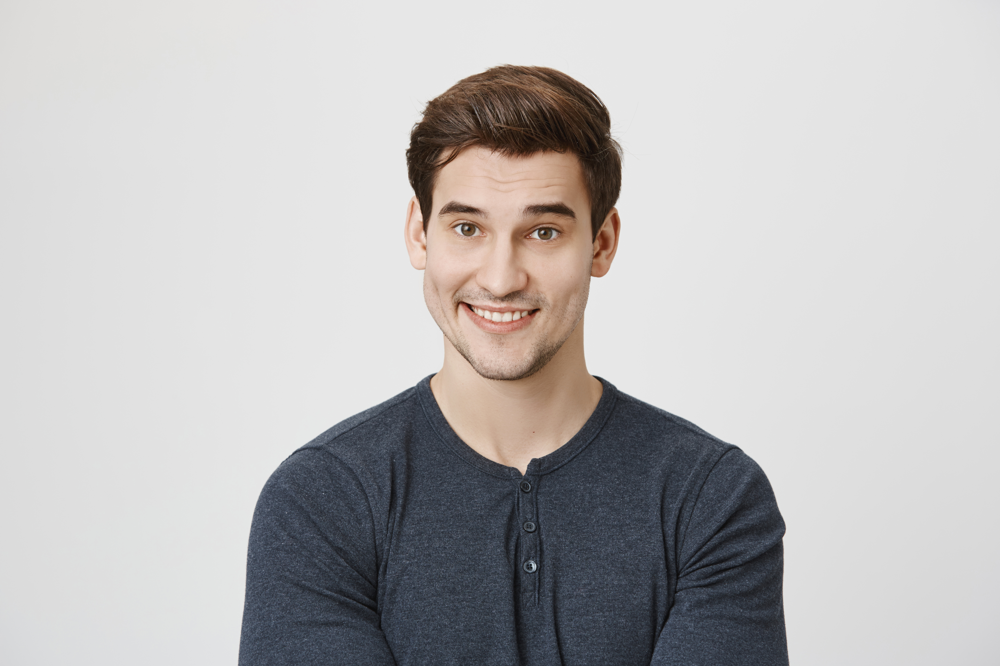

In [47]:
import PIL.Image

img = PIL.Image.open('/content/man.jpg')
img

In [52]:
from langchain.schema import HumanMessage # Import HumanMessage class from langchain.schema

import base64
import PIL.Image
from io import BytesIO # Import BytesIO from io module

# Load the image
img = PIL.Image.open('/content/man.jpg')

# Convert the image to base64
buffered = BytesIO()
img.save(buffered, format="JPEG")
img_str = base64.b64encode(buffered.getvalue()).decode()

# example
message = HumanMessage(
    content=[
        {
            "type": "text",
            "text": "Write a short description about the product shown in the image for mentioning it on ecommerce website",
        },
        {"type": "image_url", "image_url": f"data:image/jpeg;base64,{img_str}"}, # Changed to base64 encoded string
    ]
)
llm.invoke([message])

AIMessage(content='Here are a few options for a short product description for the grey Henley shirt shown in the image:\n\n**Option 1 (Concise):**\n\n> Classic Henley shirt. Comfortable and versatile for everyday wear.\n\n**Option 2 (Slightly More Detailed):**\n\n>  Elevated casual style with our grey Henley shirt. Features a soft, comfortable fabric and a stylish button-up neckline. Perfect for layering or wearing on its own.\n\n**Option 3 (Focus on Comfort):**\n\n>  Relax in style with this grey Henley. Made from a soft, breathable fabric for all-day comfort.\n\nChoose the one that best fits your brand voice and target audience!', additional_kwargs={}, response_metadata={'prompt_feedback': {'block_reason': 0, 'safety_ratings': []}, 'finish_reason': 'STOP', 'safety_ratings': []}, id='run-778fc199-82b8-4a8d-8419-73205f67c81f-0', usage_metadata={'input_tokens': 3371, 'output_tokens': 139, 'total_tokens': 3510, 'input_token_details': {'cache_read': 0}})

# Chat with Documents using RAG (Retreival Augment Generation)

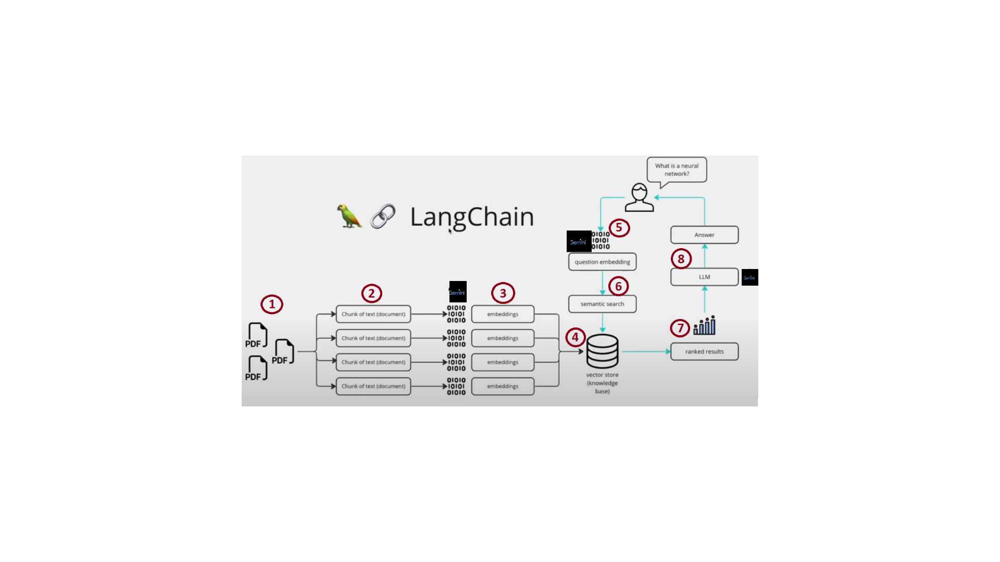

In [53]:
import PIL.Image

img = PIL.Image.open('/content/rag.png')
img

In [54]:
!sudo apt -y -qq install tesseract-ocr libtesseract-dev

!sudo apt-get -y -qq install poppler-utils libxml2-dev libxslt1-dev antiword unrtf poppler-utils pstotext tesseract-ocr flac ffmpeg lame libmad0 libsox-fmt-mp3 sox libjpeg-dev swig

!pip install langchain

libtesseract-dev is already the newest version (4.1.1-2.1build1).
tesseract-ocr is already the newest version (4.1.1-2.1build1).
0 upgraded, 0 newly installed, 0 to remove and 30 not upgraded.


In [55]:
import urllib
import warnings
from pathlib import Path as p
from pprint import pprint

import pandas as pd
from langchain import PromptTemplate
from langchain.chains.question_answering import load_qa_chain
from langchain.document_loaders import PyPDFLoader
from langchain.text_splitter import RecursiveCharacterTextSplitter
from langchain.vectorstores import Chroma
from langchain.chains import RetrievalQA



warnings.filterwarnings("ignore")
# restart python kernal if issues with langchain import.

In [56]:
from langchain_google_genai import ChatGoogleGenerativeAI

In [58]:
model = ChatGoogleGenerativeAI(model=MODEL_ID,google_api_key=GOOGLE_API_KEY,
                             temperature=0.2,convert_system_message_to_human=True)

# Extract text from the PDF

In [59]:
pdf_loader = PyPDFLoader("/content/SQL.pdf")
pages = pdf_loader.load_and_split()
print(pages[3].page_content)

● CREATEINDEX:
○ Usedtocreateanindexononeormorecolumnsinatable.○ Improvesqueryperformancebyenablingfasterdataretrieval.○ Example:CREATEINDEXidx_employee_nameONemployees(name);
● DROPINDEX:
○ Usedtoremoveanexistingindexfromatable.○ Example:DROPINDEXidx_employee_name;
● CREATECONSTRAINT:
○ Usedtodefineconstraintsthatensuredataintegrity.○ ConstraintsincludePRIMARYKEY,FOREIGNKEY,UNIQUE,NOTNULL,andCHECK.○ Example:ALTERTABLEordersADDCONSTRAINTfk_customerFOREIGNKEY(customer_id)REFERENCEScustomers(id);
● DROPCONSTRAINT:
○ Usedtoremoveanexistingconstraintfromatable.○ Example:ALTERTABLEordersDROPCONSTRAINTfk_customer;
● TRUNCATETABLE:
○ Usedtodeletethedatainsideatable,butnotthetableitself.○ Syntax–TRUNCATETABLEtable_name
2. DATAQUERY/RETRIEVALLANGUAGE(DQLorDRL)
DQL(DataQueryLanguage)isasubsetofSQLfocusedonretrievingdatafromdatabases.
TheSELECTstatementisthefoundationofDQLandallowsustoextractspecificcolumnsfromatable.
● SELECT:
TheSELECTstatementisusedtoselectdatafromadatabase.


In [60]:
len(pages)

29

# RAG Pipeline: Embedding + Gemini (LLM)

In [61]:
from langchain_google_genai import GoogleGenerativeAIEmbeddings

In [62]:
text_splitter = RecursiveCharacterTextSplitter(chunk_size=10000, chunk_overlap=1000)
context = "\n\n".join(str(p.page_content) for p in pages)
texts = text_splitter.split_text(context)

In [63]:
embeddings = GoogleGenerativeAIEmbeddings(model="models/embedding-001",google_api_key=GOOGLE_API_KEY)

In [64]:
vector_index = Chroma.from_texts(texts, embeddings).as_retriever(search_kwargs={"k":5})

In [65]:
qa_chain = RetrievalQA.from_chain_type(
    model,
    retriever=vector_index,
    return_source_documents=True

)

In [74]:
question = "Explain Types of SQL Commands in detail?"
result = qa_chain({"query": question})
result["result"]

'SQL commands are categorized into five types:\n\n1.  **DQL (Data Query Language):** Used to retrieve data from databases (e.g., SELECT).\n2.  **DDL (Data Definition Language):** Used to create, alter, and delete database objects like tables and indexes (e.g., CREATE, DROP, ALTER, RENAME, TRUNCATE).\n3.  **DML (Data Manipulation Language):** Used to modify data within the database (e.g., INSERT, UPDATE, DELETE).\n4.  **DCL (Data Control Language):** Used to manage access rights and permissions (e.g., GRANT, REVOKE).\n5.  **TCL (Transaction Control Language):** Used to manage transactions (e.g., COMMIT, ROLLBACK, SAVEPOINT).\n\nThanks for asking!'

In [75]:
Markdown(result["result"])

SQL commands are categorized into five types:

1.  **DQL (Data Query Language):** Used to retrieve data from databases (e.g., SELECT).
2.  **DDL (Data Definition Language):** Used to create, alter, and delete database objects like tables and indexes (e.g., CREATE, DROP, ALTER, RENAME, TRUNCATE).
3.  **DML (Data Manipulation Language):** Used to modify data within the database (e.g., INSERT, UPDATE, DELETE).
4.  **DCL (Data Control Language):** Used to manage access rights and permissions (e.g., GRANT, REVOKE).
5.  **TCL (Transaction Control Language):** Used to manage transactions (e.g., COMMIT, ROLLBACK, SAVEPOINT).

Thanks for asking!

In [76]:
result["source_documents"]

[Document(metadata={}, page_content='Computestheaverageofnumericvaluesinagrouporresultset.\n- MAX():Findsthemaximumvalueinagrouporresultset.\n- MIN():Retrievestheminimumvalueinagrouporresultset.\n3. DATAMANIPULATIONLANGUAGE\nDataManipulationLanguage(DML)inSQLencompassescommandsthatmanipulatedatawithinadatabase.DMLallowsyoutoinsert,update,anddeleterecords,ensuringtheaccuracyandcurrencyofyourdata.\n● INSERT:\n- TheINSERTstatementaddsnewrecordstoatable.- Syntax:INSERTINTOtable_name(column1,column2,...)VALUES(value1,value2,...);\n- Example:INSERTINTOemployees(first_name,last_name,salary)VALUES(\'John\',\'Doe\',50000);\n● UPDATE:\n- TheUPDATEstatementmodifiesexistingrecordsinatable.- Syntax:UPDATEtable_nameSETcolumn1=value1,column2=value2,...WHEREcondition;- Example:UPDATEemployeesSETsalary=55000WHEREfirst_name=\'John\';\n● DELETE:\n- TheDELETEstatementremovesrecordsfromatable.- Syntax:DELETEFROMtable_nameWHEREcondition;- Example:DELETEFROMemployeesWHERElast_name=\'Doe\';\n4. DataControlLan

In [77]:
template = """Use the following pieces of context to answer the question at the end. If you don't know the answer, just say that you don't know, don't try to make up an answer. Keep the answer as concise as possible. Always say "thanks for asking!" at the end of the answer.
{context}
Question: {question}
Helpful Answer:"""
QA_CHAIN_PROMPT = PromptTemplate.from_template(template)# Run chain
qa_chain = RetrievalQA.from_chain_type(
    model,
    retriever=vector_index,
    return_source_documents=True,
    chain_type_kwargs={"prompt": QA_CHAIN_PROMPT}
)

In [82]:
question = "What is RDBMS?"
result = qa_chain({"query": question})
result["result"]

'RDBMS (Relational Database Management System) is a DBMS based on the concept of tables (also called relations). Data is organized into tables with rows (records) and columns (attributes). Examples include MySQL, PostgreSQL, and Oracle.\n\nThanks for asking!'

In [83]:
Markdown(result["result"])

RDBMS (Relational Database Management System) is a DBMS based on the concept of tables (also called relations). Data is organized into tables with rows (records) and columns (attributes). Examples include MySQL, PostgreSQL, and Oracle.

Thanks for asking!

In [84]:
question = "Explain Joins? also explain its types"
result = qa_chain({"query": question})
Markdown(result["result"])

Joins combine rows from two or more tables based on a related column. Types of joins include:

1.  **Inner Join**: Returns rows with matching values in both tables.
2.  **Outer Join**: Includes rows that don't have matching values in both tables.
    *   **Left Outer Join**: Returns all rows from the left table and matching rows from the right table.
    *   **Right Outer Join**: Returns all rows from the right table and matching rows from the left table.
    *   **Full Outer Join**: Returns all rows from both tables, including matches and non-matches.
3.  **Cross Join**: Combines every row from one table with every row from another table (Cartesian product).
4.  **Self Join**: Joins a table with itself.

Thanks for asking!